# <span><h1 style = "font-family: garamond; font-size: 40px; font-style: normal; letter-spcaing: 3px; background-color: #ffbace; color :  #e30b0b; border-radius: 100px 100px; text-align:center">0. Preambule</h1></span>

The code is reday! I'm still working on this....

![single-cell](https://upload.wikimedia.org/wikipedia/commons/thumb/4/45/Fluorescence_Assisted_Cell_Sorting_%28FACS%29_B2.jpg/800px-Fluorescence_Assisted_Cell_Sorting_%28FACS%29_B2.jpg)

## <span><h1 style = "font-family: garamond; font-size: 30px; font-style: normal; letter-spcaing: 1.5px; background-color: #ffbace; color :  #e30b0b; border-radius: 100px 100px; text-align:center">0.1 Disclaimer</h1></span>

<div class="alert alert-block alert-info">
    <font color = "red"></font> The following work don't use all the batches available, Kaggle's machines doesn't have enough RAM and VRAM to handle all the data.
</div>

## <span><h1 style = "font-family: garamond; font-size: 30px; font-style: normal; letter-spcaing: 1.5px; background-color: #ffbace; color :  #e30b0b; border-radius: 100px 100px; text-align:center">0.2 Installing Libraries</h1></span>

In [1]:
!pip install fa2
!pip install scmer
!pip install scanpy
!pip install louvain
!pip install leidenalg

     |████████████████████████████████| 435 kB 917 kB/s 
  Created wheel for fa2: filename=fa2-0.3.5-cp37-cp37m-linux_x86_64.whl size=297523 sha256=14c9ee9de1b4771ec69f66f40b280032c1d349f7354c85f79dbe4b8dfe5971a0
  Stored in directory: /root/.cache/pip/wheels/d3/b5/0a/df14cac170d872be0dd0300309b7463b5e52d936c3edce7963
Successfully built fa2
     |████████████████████████████████| 2.0 MB 917 kB/s 
     |████████████████████████████████| 91 kB 8.7 MB/s 
     |████████████████████████████████| 103 kB 64.5 MB/s 
     |████████████████████████████████| 63 kB 2.1 MB/s 
  Created wheel for sinfo: filename=sinfo-0.3.4-py3-none-any.whl size=7899 sha256=af9c79c5a0f8eebe807de010f18e4374be5074b6e8a691208608cf8bb5ea5b0a
  Stored in directory: /root/.cache/pip/wheels/68/ca/56/344d532fe53e855ccd6549795d370588ab8123907eecf4cf30
Successfully built sinfo
     |████████████████████████████████| 2.1 MB 925 kB/s 
     |████████████████████████████████| 1.4 MB 919 kB/s 


## <span><h1 style = "font-family: garamond; font-size: 30px; font-style: normal; letter-spcaing: 1.5px; background-color: #ffbace; color :  #e30b0b; border-radius: 100px 100px; text-align:center">0.3 Loading Libraries</h1></span>

In [2]:
### General ###
import os
import random
import numpy as np
import pandas as pd
import pickle as pkl

### Single-Cell ###
import scanpy as sc
import anndata as ad
from scmer import UmapL1

### Visualization ###
import matplotlib as mpl
from colorama import Fore
from matplotlib import rcParams
import matplotlib.pyplot as plt

### Torch Ecosystem ###
import torch

## <span><h1 style = "font-family: garamond; font-size: 30px; font-style: normal; letter-spcaing: 1.5px; background-color: #ffbace; color :  #e30b0b; border-radius: 100px 100px; text-align:center">0.4 Configuration</h1></span>

In [3]:
seed = 42

def set_seed(seed):
    random.seed(seed)
    np.random.seed(seed)
    torch.manual_seed(seed)
    os.environ["PYTHONHASHSEED"] = str(seed)
    
    if torch.cuda.is_available():
        torch.cuda.manual_seed(seed)
        torch.cuda.manual_seed_all(seed)
        torch.backends.cudnn.deterministic = True
        torch.backends.cudnn.benchmark = False

set_seed(seed)

In [4]:
sc.settings.verbosity = 3  # verbosity: errors (0), warnings (1), info (2), hints (3)

In [5]:
b_ = Fore.BLUE
g_ = Fore.GREEN
m_ = Fore.MAGENTA
r_ = Fore.RED
y_ = Fore.YELLOW

# <span><h1 style = "font-family: garamond; font-size: 40px; font-style: normal; letter-spcaing: 3px; background-color: #ffbace; color :  #e30b0b; border-radius: 100px 100px; text-align:center">1. The Data</h1></span>

In [6]:
adata = ad.read_h5ad("../input/singlecell-multiomics/multiome_gex_processed_training.h5ad")

In [7]:
print(f"{b_}The Gene Expression (GEX) data has {r_}{adata.n_obs}{b_} observations and {r_}{adata.n_vars}{b_} features.")

The Gene Expression (GEX) data has 22463 observations and 13431 features.


In [8]:
print(f"{b_}adata.X.shape: {r_}{adata.X.shape}")

adata.X.shape: (22463, 13431)


## <span><h1 style = "font-family: garamond; font-size: 30px; font-style: normal; letter-spcaing: 1.5px; background-color: #ffbace; color :  #e30b0b; border-radius: 100px 100px; text-align:center">1.1 What is inside?</h1></span>

In [9]:
adata

AnnData object with n_obs × n_vars = 22463 × 13431
    obs: 'n_genes_by_counts', 'pct_counts_mt', 'n_counts', 'n_genes', 'size_factors', 'phase', 'cell_type', 'pseudotime_order_GEX', 'batch'
    var: 'gene_ids', 'feature_types', 'genome'
    uns: 'dataset_id', 'organism'
    obsm: 'X_pca', 'X_umap'
    layers: 'counts', 'log_norm'

In [10]:
adata.obs

,n_genes_by_counts,pct_counts_mt,n_counts,n_genes,size_factors,phase,cell_type,pseudotime_order_GEX,batch
TAGTTGTCACCCTCAC-1-s1d1,1022,1.061008,1508.0,1022,0.453484,S,Naive CD20+ B,NaN,s1d1
CTATGGCCATAACGGG-1-s1d1,1081,0.604230,1655.0,1081,0.455631,G2M,CD14+ Mono,NaN,s1d1
CCGCACACAGGTTAAA-1-s1d1,3304,0.650069,7230.0,3304,2.435348,G2M,CD8+ T,NaN,s1d1
TCATTTGGTAATGGAA-1-s1d1,793,0.812274,1108.0,793,0.347226,G2M,CD8+ T,NaN,s1d1
ACCACATAGGTGTCCA-1-s1d1,1219,1.674770,1851.0,1219,0.534205,G2M,CD16+ Mono,NaN,s1d1
...,...,...,...,...,...,...,...,...,...
TAGTAAGCAACTAGGG-8-s3d6,1313,0.000000,1937.0,1313,0.522115,S,HSC,0.098024,s3d6
TGGTCCTTCGGCTAGC-8-s3d6,2846,0.015901,6289.0,2846,1.737451,G2M,CD4+ T activated,NaN,s3d6
CGCTTGCGTTGTTGGA-8-s3d6,983,0.000000,1390.0,983,0.291723,G2M,pDC,NaN,s3d6
ACCCTCCCAGCCAGTT-8-s3d6,1351,0.000000,2190.0,1351,0.585303,G2M,CD8+ T,NaN,s3d6


In [11]:
adata.var

,gene_ids,feature_types,genome
AL627309.5,ENSG00000241860,GEX,GRCh38
LINC01409,ENSG00000237491,GEX,GRCh38
LINC01128,ENSG00000228794,GEX,GRCh38
NOC2L,ENSG00000188976,GEX,GRCh38
KLHL17,ENSG00000187961,GEX,GRCh38
...,...,...,...
MT-ND5,ENSG00000198786,GEX,GRCh38
MT-ND6,ENSG00000198695,GEX,GRCh38
MT-CYB,ENSG00000198727,GEX,GRCh38
AL592183.1,ENSG00000273748,GEX,GRCh38


In [12]:
print(f"{g_}Batches: {b_}", adata.obs["batch"].unique())

Batches:  ['s1d1', 's1d2', 's2d1', 's2d4', 's3d6']
Categories (5, object): ['s1d1', 's1d2', 's2d1', 's2d4', 's3d6']


## <span><h1 style = "font-family: garamond; font-size: 30px; font-style: normal; letter-spcaing: 1.5px; background-color: #ffbace; color :  #e30b0b; border-radius: 100px 100px; text-align:center">1.2 Slicing the Data</h1></span>

In [13]:
train = adata[adata.obs["batch"].isin(["s1d2", "s2d1", "s3d6"])]
print(f"{b_}train.X.shape: {r_}{train.X.shape}")

train.X.shape: (11391, 13431)


# <span><h1 style = "font-family: garamond; font-size: 40px; font-style: normal; letter-spcaing: 3px; background-color: #ffbace; color :  #e30b0b; border-radius: 100px 100px; text-align:center">2. Visualization and Preprocessing</h1></span>

## <span><h1 style = "font-family: garamond; font-size: 30px; font-style: normal; letter-spcaing: 1.5px; background-color: #ffbace; color :  #e30b0b; border-radius: 100px 100px; text-align:center">2.1 Visualization of gene expression and other variables</h1></span>

normalizing counts per cell
    finished (0:00:00)


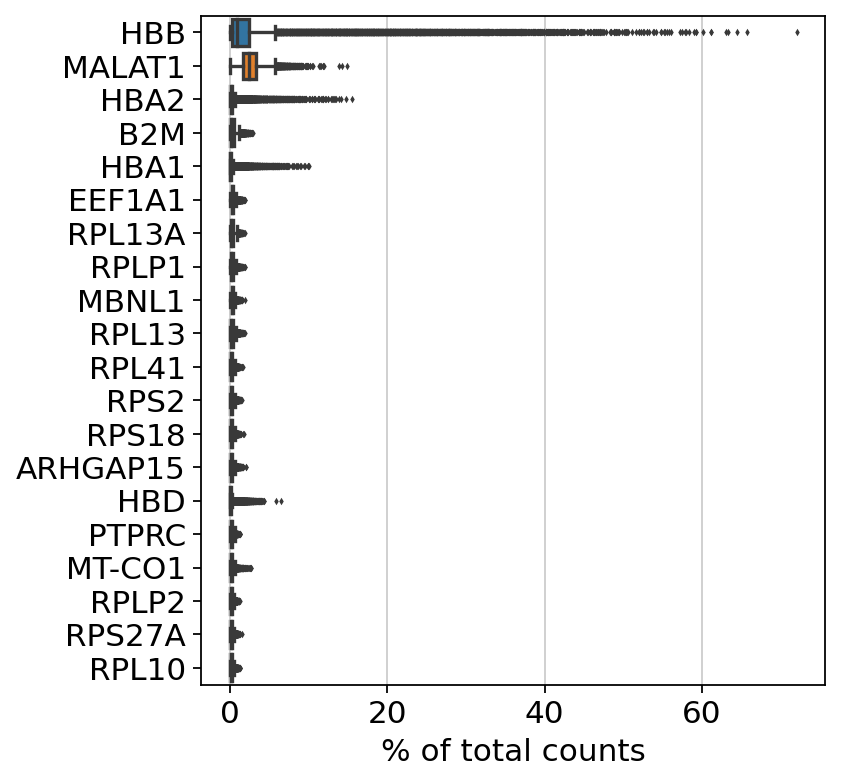

In [14]:
sc.settings.set_figure_params(dpi = 80, facecolor = "white")
sc.pl.highest_expr_genes(adata, n_top = 20)

/opt/conda/lib/python3.7/site-packages/scanpy/preprocessing/_normalization.py:155: UserWarning: Revieved a view of an AnnData. Making a copy.
  view_to_actual(adata)


normalizing counts per cell
    finished (0:00:00)


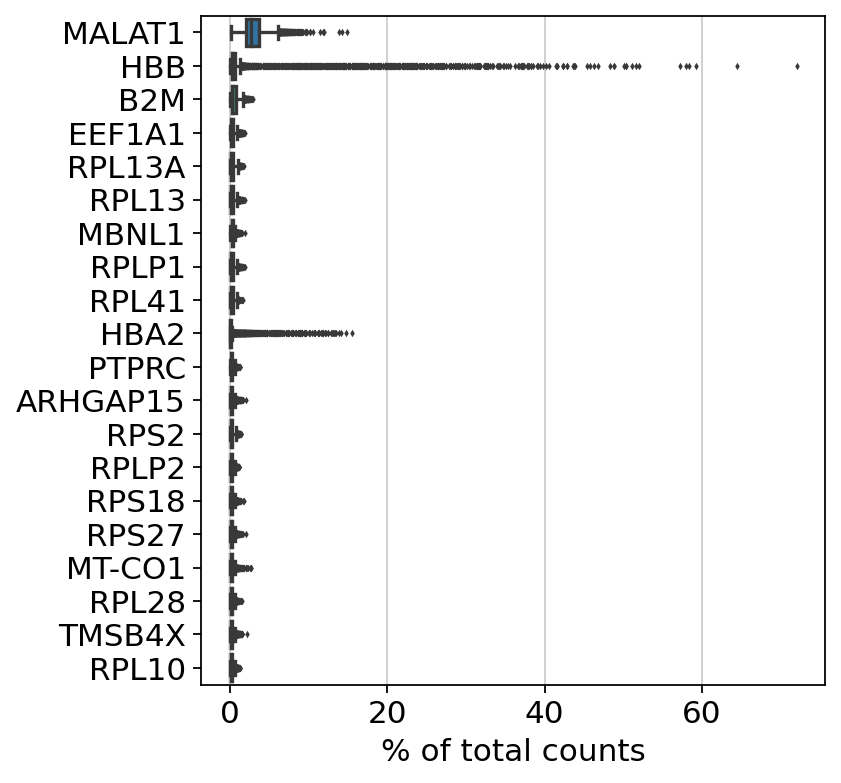

In [15]:
sc.settings.set_figure_params(dpi = 80, facecolor = "white")
sc.pl.highest_expr_genes(train, n_top = 20)

In [16]:
sc.pp.filter_cells(train, min_genes = 100)
sc.pp.filter_genes(train, min_cells = 3)

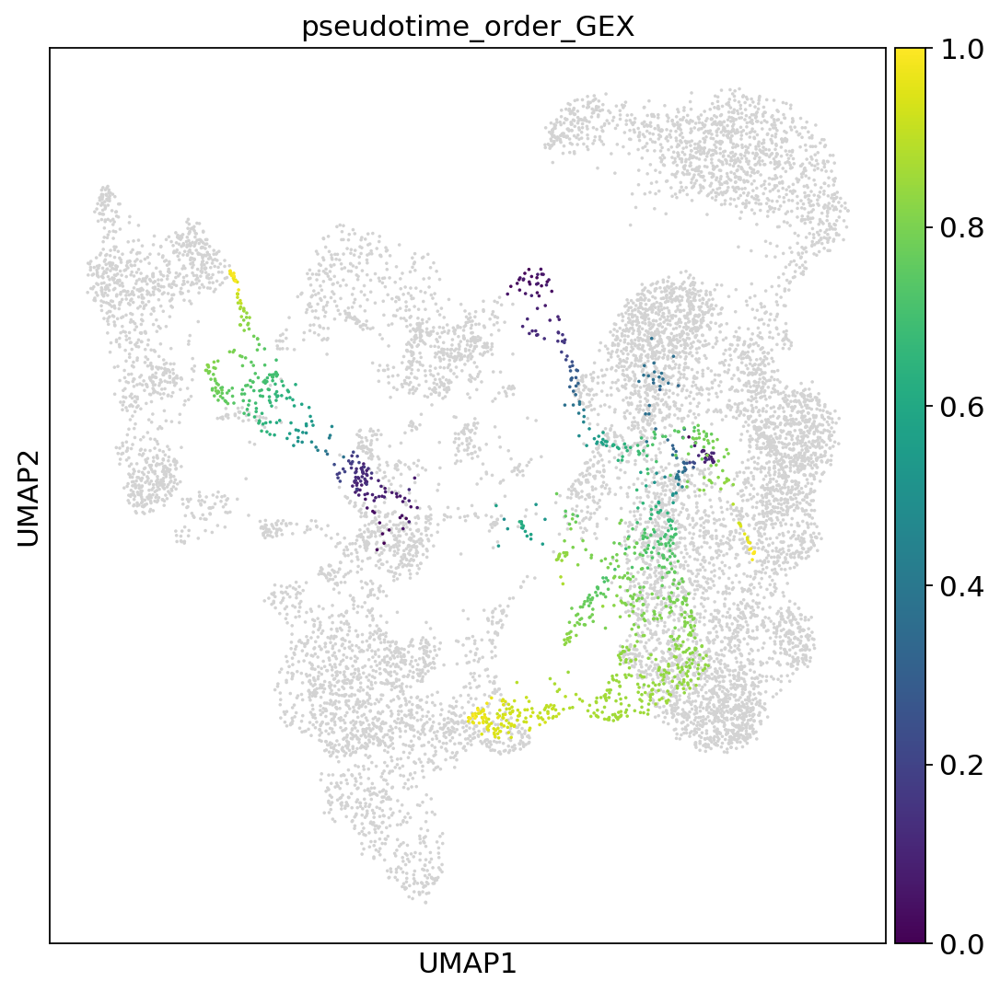

In [17]:
with plt.rc_context({"figure.figsize": (8, 8)}):
    sc.pl.umap(train, color = "pseudotime_order_GEX")

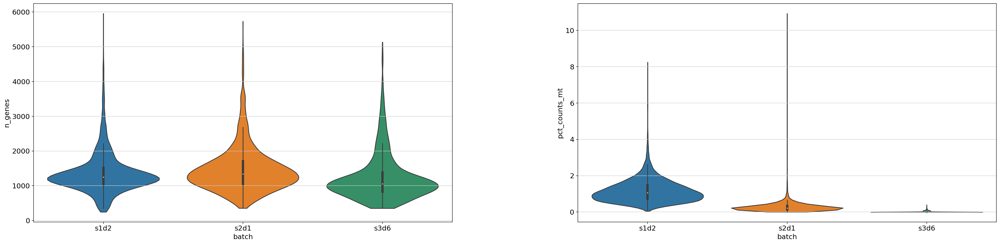

In [18]:
 with plt.rc_context({"figure.figsize": (12, 8)}):
    sc.pl.violin(
     train, 
     ["n_genes", "pct_counts_mt"], 
     groupby = "batch", 
     stripplot = False, 
     inner = "box"
 )

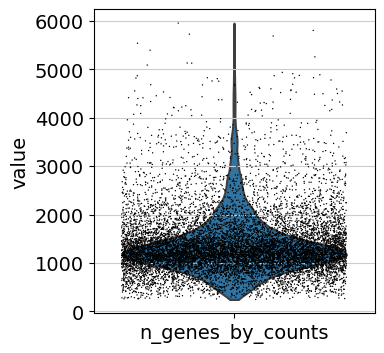

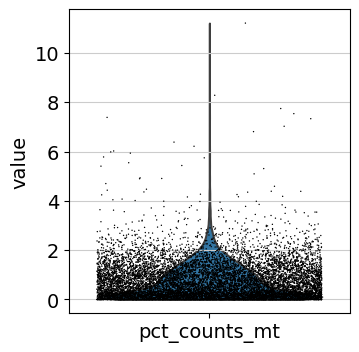

In [19]:
sc.settings.set_figure_params(dpi = 50, facecolor = "white")

# Annotate the group of mitochondrial genes as "mt"
train.var["mt"] = train.var.index.str.startswith("MT-")
sc.pp.calculate_qc_metrics(
    train, 
    log1p = False, 
    inplace = True,
    qc_vars = ["mt"], 
    percent_top = None
)
sc.pl.violin(train, ["n_genes_by_counts"], jitter = 0.4)
sc.pl.violin(train, ["pct_counts_mt"], jitter = 0.4)

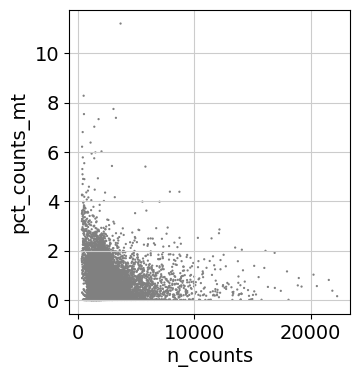

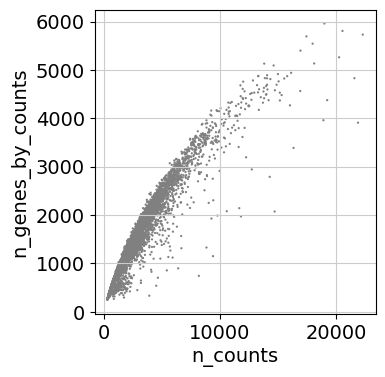

In [20]:
sc.settings.set_figure_params(dpi = 50, facecolor = "white")

sc.pl.scatter(train, x = "n_counts", y = "pct_counts_mt")
sc.pl.scatter(train, x = "n_counts", y = "n_genes_by_counts")

## <span><h1 style = "font-family: garamond; font-size: 30px; font-style: normal; letter-spcaing: 1.5px; background-color: #ffbace; color :  #e30b0b; border-radius: 100px 100px; text-align:center">2.2 Preprocessing</h1></span>

In [21]:
sc.pp.normalize_total(train, target_sum = 1e4)
sc.pp.log1p(train)

normalizing counts per cell
    finished (0:00:00)


extracting highly variable genes
    finished (0:00:01)
--> added
    'highly_variable', boolean vector (adata.var)
    'means', float vector (adata.var)
    'dispersions', float vector (adata.var)
    'dispersions_norm', float vector (adata.var)


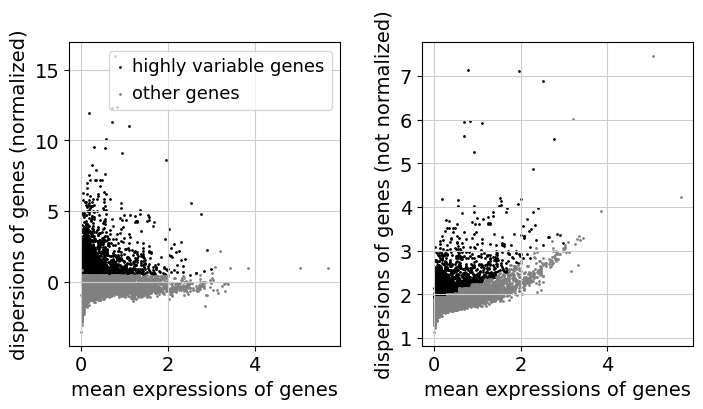

2549

In [22]:
sc.pp.highly_variable_genes(train)
sc.pl.highly_variable_genes(train)

train.var.highly_variable.sum()

In [23]:
train.raw = train

In [24]:
train = train[:, train.var.highly_variable]

In [25]:
sc.pp.scale(train, max_value = 10)

... as `zero_center=True`, sparse input is densified and may lead to large memory consumption


/opt/conda/lib/python3.7/site-packages/scanpy/preprocessing/_simple.py:843: UserWarning: Revieved a view of an AnnData. Making a copy.
  view_to_actual(adata)


## <span><h1 style = "font-family: garamond; font-size: 30px; font-style: normal; letter-spcaing: 1.5px; background-color: #ffbace; color :  #e30b0b; border-radius: 100px 100px; text-align:center">2.3 Visualization of highly variable genes</h1></span>

computing PCA
    on highly variable genes
    with n_comps=50
    finished (0:00:03)


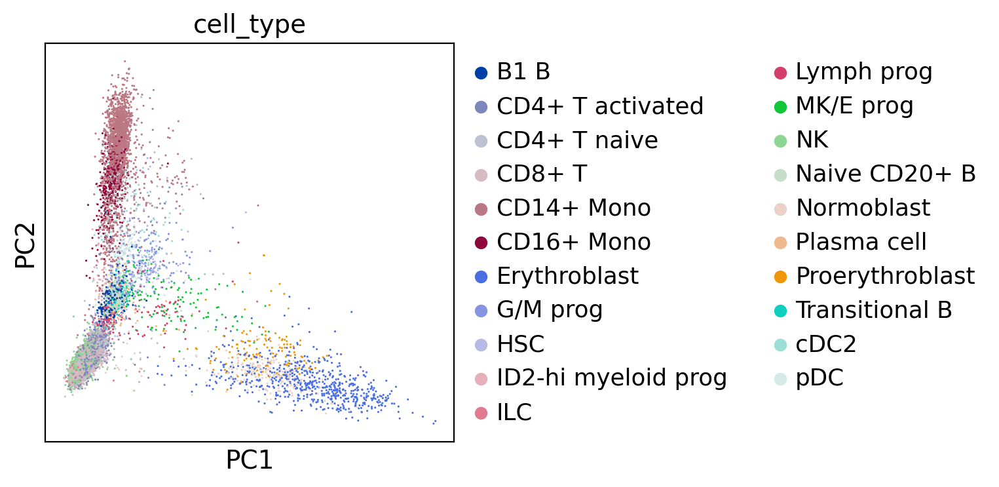

In [26]:
sc.settings.set_figure_params(dpi = 100, facecolor = "white")
sc.tl.pca(train, svd_solver = "arpack")
sc.pl.pca(train, color = ["cell_type"], size = 5.)

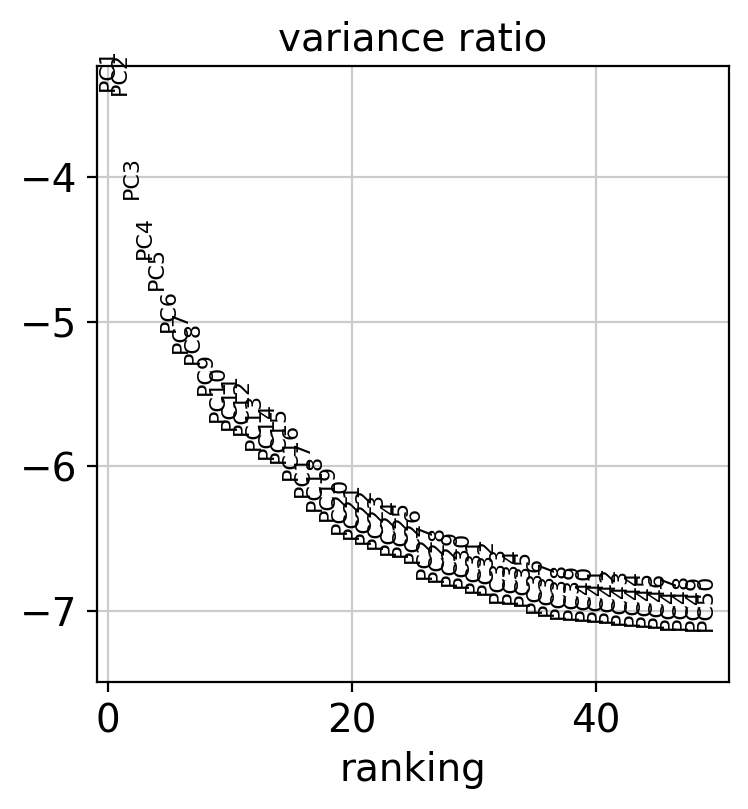

In [27]:
sc.pl.pca_variance_ratio(train, log = True, n_pcs = 50)

In [28]:
sc.pp.neighbors(train, n_pcs = 25)
sc.tl.umap(train)

computing neighbors
    using 'X_pca' with n_pcs = 25
    finished: added to `.uns['neighbors']`
    `.obsp['distances']`, distances for each pair of neighbors
    `.obsp['connectivities']`, weighted adjacency matrix (0:00:36)
computing UMAP
    finished: added
    'X_umap', UMAP coordinates (adata.obsm) (0:00:13)


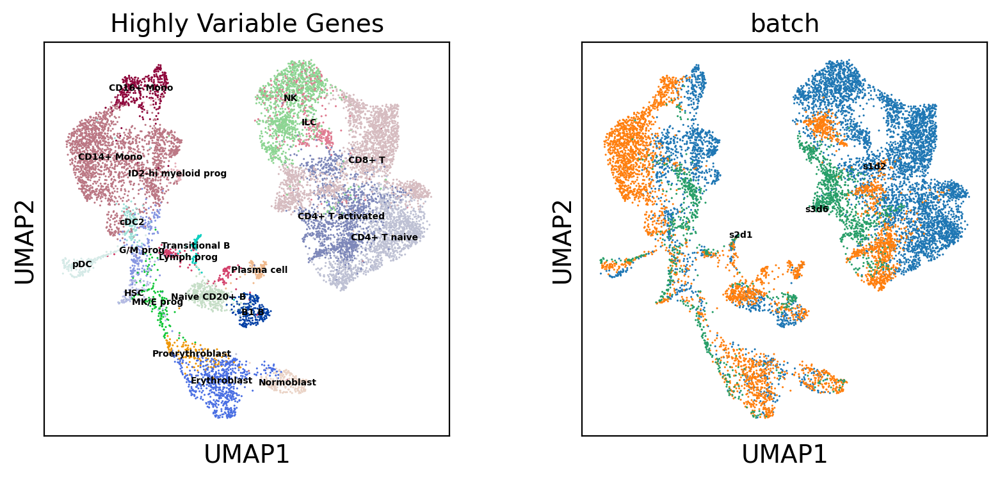

In [29]:
sc.settings.set_figure_params(dpi = 100, facecolor = "white")
sc.pl.umap(
    train, 
    color = ["cell_type", "batch"], 
    legend_loc = "on data",
    size = 5.,
    legend_fontsize = 5,
    title = "Highly Variable Genes"
)

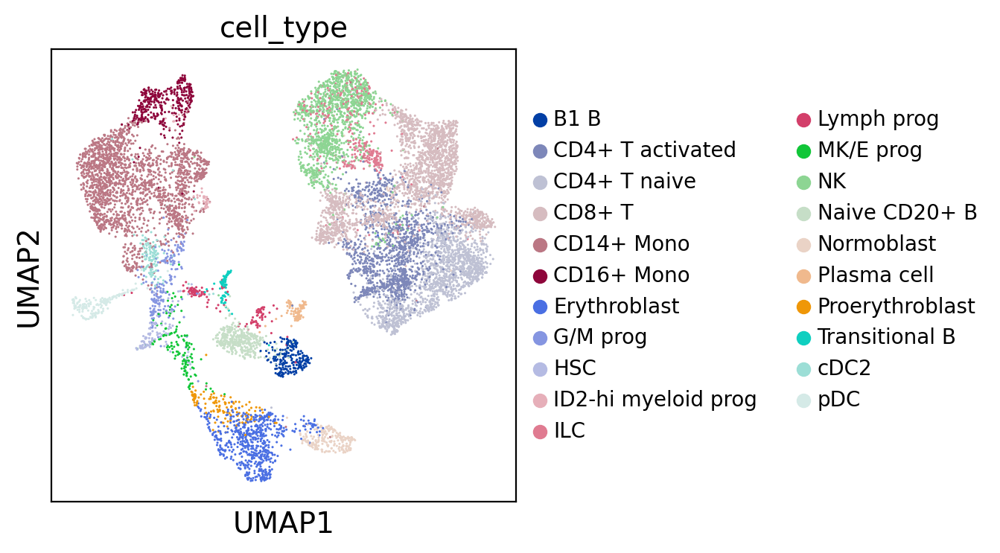

In [30]:
# Cleaner vis
sc.pl.umap(
    train, 
    color = ["cell_type"], 
    size = 5., 
    legend_fontsize = 10
)

## <span><h1 style = "font-family: garamond; font-size: 40px; font-style: normal; letter-spcaing: 3px; background-color: #ffbace; color :  #e30b0b; border-radius: 100px 100px; text-align:center">3. SCMER (Feature Selection)</h1></span>

In [31]:
model = UmapL1(
    w = 1., 
    lasso = 3.3e-4,
    ridge = 0.,
    n_pcs = 25,
    perplexity = 100.,
    use_beta_in_Q = True,
    n_threads = os.cpu_count(),
    max_outer_iter = 3,
    use_gpu = True # It's faster with GPU
)

## <span><h1 style = "font-family: garamond; font-size: 30px; font-style: normal; letter-spcaing: 1.5px; background-color: #ffbace; color :  #e30b0b; border-radius: 100px 100px; text-align:center">3.1 Training</h1></span>

In [32]:
%%time
model.fit(train.X)

Calculating distance matrix and scaling factors...
Computing pairwise distances...
Using 2 threads...
Mean value of sigma: 0.801397
Done. Elapsed time: 994.61 seconds. Total: 994.61 seconds.
Creating model without batches...
Optimizing using OWLQN (because lasso is nonzero)...
0 loss (before this step): 5.628682613372803 Nonzero (after): 224 Elapsed time: 30.19 seconds. Total: 1024.80 seconds.
1 loss (before this step): 4.190255165100098 Nonzero (after): 219 Elapsed time: 17.63 seconds. Total: 1042.44 seconds.
2 loss (before this step): 4.189565658569336 Nonzero (after): 219 Elapsed time: 19.28 seconds. Total: 1061.72 seconds.
Final loss: 4.079282283782959 Nonzero: 219 Elapsed time: 0.19 seconds. Total: 1061.90 seconds.
CPU times: user 1min 9s, sys: 5.69 s, total: 1min 14s
Wall time: 17min 41s


## <span><h1 style = "font-family: garamond; font-size: 30px; font-style: normal; letter-spcaing: 1.5px; background-color: #ffbace; color :  #e30b0b; border-radius: 100px 100px; text-align:center">3.2 Selected Genes</h1></span>

In [33]:
selected_genes = train.var_names[model.get_mask(100)]
new_adata = train[:, selected_genes]

print(g_, "ALL SELECTED GENES: \n")
print(b_, *selected_genes)
print(y_, "=" * 60)
print(f"{m_}Number of selected genes: {r_}{len(selected_genes)}")

 ALL SELECTED GENES: 

 CSF3R JUN TGFBR3 DPYD S100A4 SPTA1 FCER1G CD247 RALGPS2 ID2 SLC8A1 GNLY IGKC AFF3 AC079793.1 SLC4A10 STAT4 IKZF2 PID1 FGFBP2 RBM47 TXK ARHGAP24 SNCA BANK1 LEF1 INPP4B MARCH1 IL7R GZMK GZMA PDE4D VCAN MEF2C MCTP1 CAMK4 CD74 EBF1 CD83 LTB HLA-DRA HLA-DRB1 HLA-DPB1 BACH2 THEMIS TNFAIP3 AOAH AUTS2 CD36 NAMPT MYOM2 SLC25A37 ANK1 LYN TOX MTSS1 PAX5 CEMIP2 FCN1 PLXDC2 ANK3 PRF1 LRMDA LINC01374 TCF7L2 SOX6 NEAT1 FCHSD2 CD69 LRRK2 IRAK3 LYZ CUX2 FRY DIAPH3 GZMH GZMB SLC25A21 SYNE2 IGHM ATP8B4 DMXL2 RORA IL32 CCL5 SLC4A1 PRKCA LINC01478 TCF4 BCL2 GADD45B HCST TYROBP NKG7 PLCB1 ERG IGLC2 TMSB4X SAT1 XACT
Number of selected genes: 100


## <span><h1 style = "font-family: garamond; font-size: 30px; font-style: normal; letter-spcaing: 1.5px; background-color: #ffbace; color :  #e30b0b; border-radius: 100px 100px; text-align:center">3.3 Comparisons</h1></span>

computing PCA
    on highly variable genes
    with n_comps=50
    finished (0:00:00)
computing PCA
    on highly variable genes
    with n_comps=50
    finished (0:00:04)


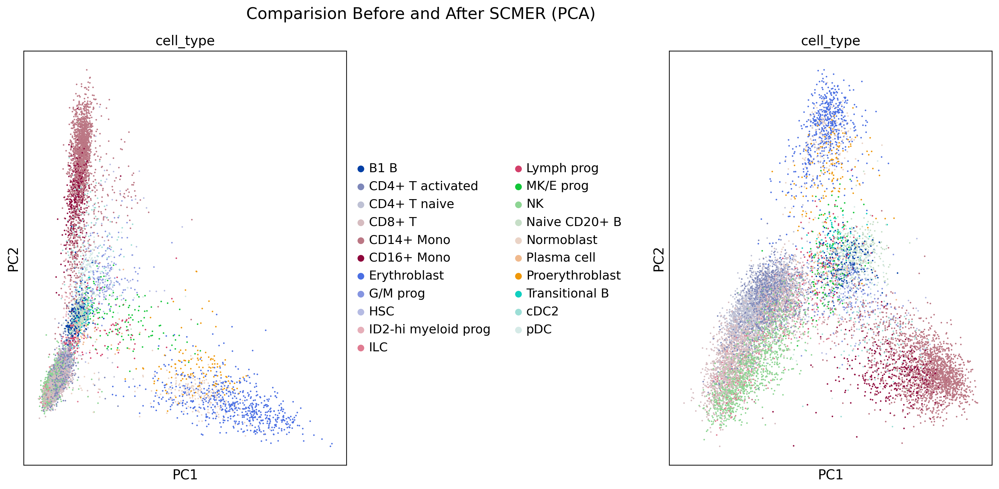

In [34]:
sc.tl.pca(new_adata, svd_solver = "arpack")
sc.tl.pca(train, svd_solver = "arpack")

fig, (ax1, ax2) = plt.subplots(1, 2, figsize = (18, 8), gridspec_kw = {"wspace": 1.0})
fig.suptitle("Comparision Before and After SCMER (PCA)")
fig.subplots_adjust(top = 0.9)

ax1_dict = sc.pl.pca(train, color = ["cell_type"], ax = ax1, show = False)
ax2_dict = sc.pl.pca(new_adata, color = ["cell_type"], ax = ax2, show = False, legend_loc = None)
plt.savefig("Comparision_Before_and_After_SCMER_PCA.png", dpi = 100)

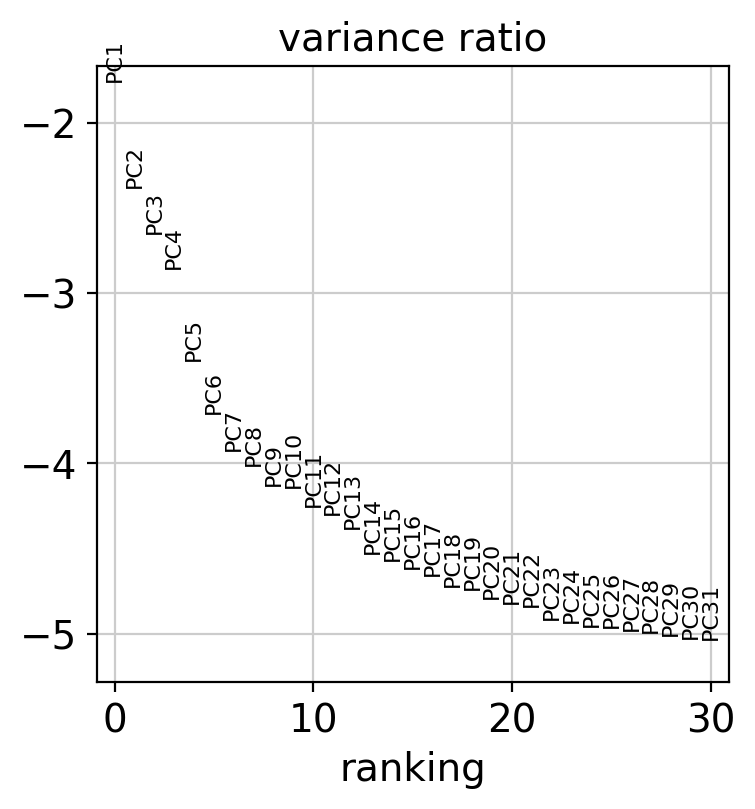

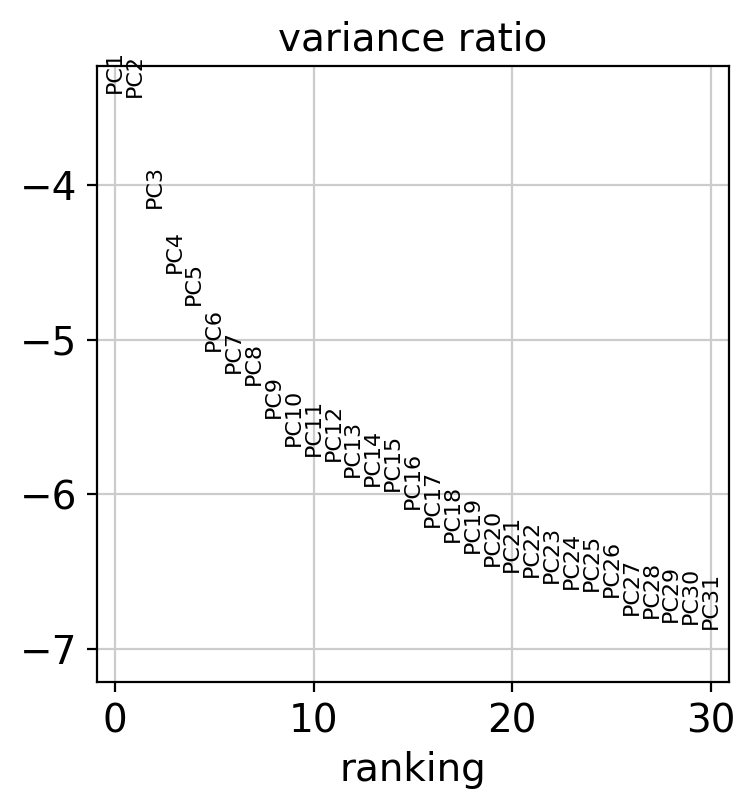

In [35]:
sc.pl.pca_variance_ratio(new_adata, log = True)
sc.pl.pca_variance_ratio(train, log = True)

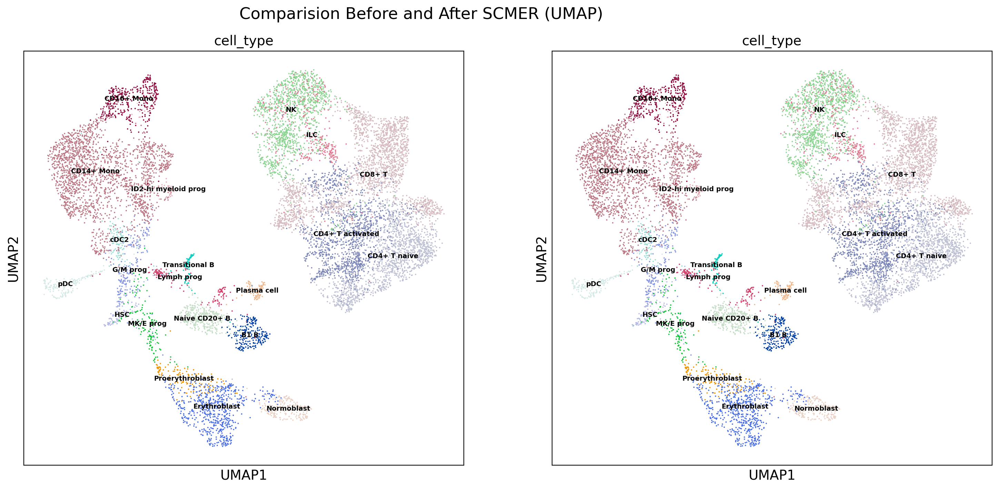

In [36]:
fig, (ax1, ax2) = plt.subplots(1, 2, figsize = (18, 8), gridspec_kw = {"wspace": 0.2})
fig.suptitle("Comparision Before and After SCMER (UMAP)")
fig.subplots_adjust(top = 0.9)

ax1_dict = sc.pl.umap(train, color = ["cell_type"], legend_loc = "on data", frameon = True, size = 8., legend_fontsize = 7, ax = ax1, show = False)
ax2_dict = sc.pl.umap(new_adata, color = ["cell_type"], legend_loc = "on data", frameon = True, size = 8., legend_fontsize = 7, ax = ax2, show = False)
plt.savefig("Comparision_Before_and_After_SCMER_UMAP.png", dpi = 100)

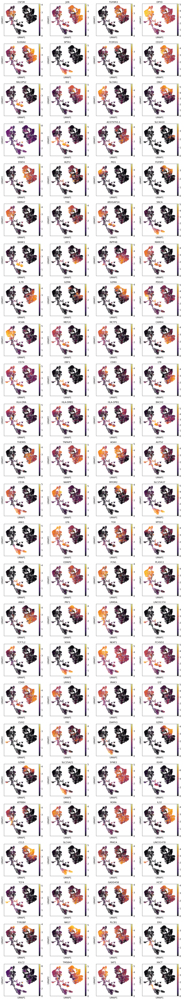

In [37]:
sc.settings.set_figure_params(dpi = 60, facecolor = "white")
sc.pl.umap(new_adata, color = selected_genes, color_map = "inferno")

    using 'X_pca' with n_pcs = 50
Storing dendrogram info using `.uns['dendrogram_cell_type']`


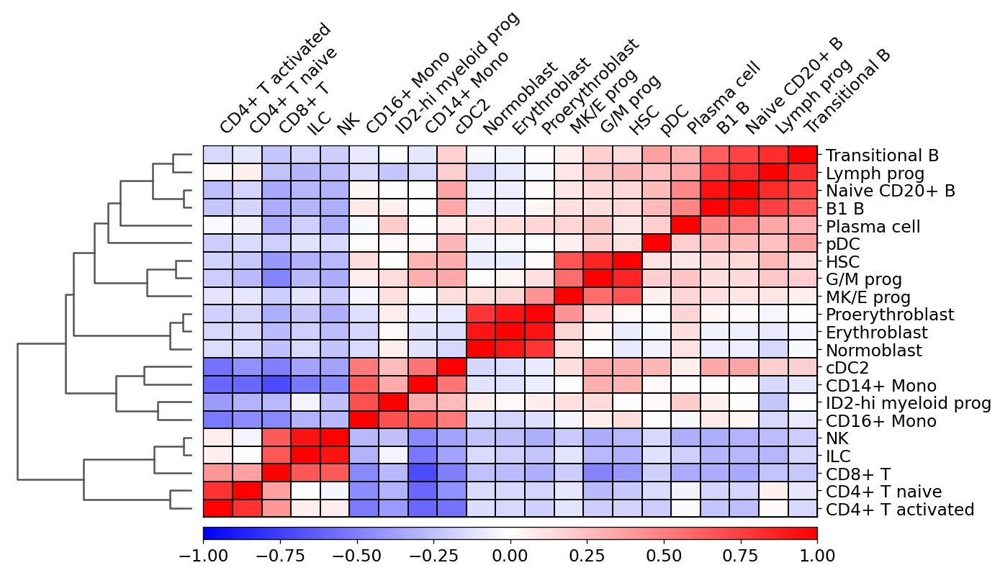

In [38]:
ax = sc.pl.correlation_matrix(
    new_adata, 
    "cell_type", 
    figsize = (12, 6)
)

# <span><h1 style = "font-family: garamond; font-size: 40px; font-style: normal; letter-spcaing: 3px; background-color: #ffbace; color :  #e30b0b; border-radius: 100px 100px; text-align:center">4. References</h1></span>

## <span><h1 style = "font-family: garamond; font-size: 30px; font-style: normal; letter-spcaing: 1.5px; background-color: #ffbace; color :  #e30b0b; border-radius: 100px 100px; text-align:center">4.1 Documentation</h1></span>

### SCMER
- [Bone Marrow Immune Cell Differentiation](https://scmer.readthedocs.io/en/latest/bone-marrow.html)
### Scanpy
- [Core plotting functions](https://scanpy-tutorials.readthedocs.io/en/latest/plotting/core.html)

## <span><h1 style = "font-family: garamond; font-size: 30px; font-style: normal; letter-spcaing: 1.5px; background-color: #ffbace; color :  #e30b0b; border-radius: 100px 100px; text-align:center">4.2 Papers</h1></span>

- Luecken, M. D., & Theis, F. J. (2019). Current best practices in single‐cell RNA‐seq analysis: a tutorial. Molecular systems biology, 15(6), e8746.
- Wolf, F. A., Angerer, P., & Theis, F. J. (2018). SCANPY: large-scale single-cell gene expression data analysis. Genome biology, 19(1), 1-5.
- Liang, S., Mohanty, V., Dou, J., Miao, Q., Huang, Y., Müftüoğlu, M., ... & Chen, K. (2021). Single-cell manifold-preserving feature selection for detecting rare cell populations. Nature Computational Science, 1(5), 374-384.